In [1]:
from pathlib import Path
import numpy as np
import pandas as pd
import xarray as xr
import matplotlib.pyplot as plt

# --- path to the single merged file ---
NC_PATH = Path("../data/processed/era5_caspian_2025_04_06.nc")

# --- helpers ---
def normalize_coords(ds: xr.Dataset) -> xr.Dataset:
    """Rename to time/lat/lon, sort, keep in-memory (fast for plotting)."""
    ren = {}
    if "latitude"  in ds.dims or "latitude"  in ds.coords: ren["latitude"]  = "lat"
    if "longitude" in ds.dims or "longitude" in ds.coords: ren["longitude"] = "lon"
    for tname in ("time","valid_time","t","Time"):
        if tname in ds.dims or tname in ds.coords:
            if tname != "time": ren[tname] = "time"
            break
    ds = ds.rename(ren)
    if "time" in ds: ds = ds.sortby("time")
    if "lat"  in ds: ds = ds.sortby("lat")
    if "lon"  in ds: ds = ds.sortby("lon")
    return ds.load()

def pick_var(d: xr.Dataset, options):
    for k in options:
        if k in d: return d[k]
    raise KeyError(f"None of {options} found. Vars: {list(d.data_vars)}")

def to_celsius(da: xr.DataArray) -> xr.DataArray:
    units = str(da.attrs.get("units","")).lower()
    if "k" in units or float(da.max()) > 200:
        out = da - 273.15
        out.attrs.update(da.attrs); out.attrs["units"] = "°C"
        return out
    return da

# --- open + harmonize ---
ds = xr.open_dataset(NC_PATH, engine="netcdf4")
ds = normalize_coords(ds)

# variables (robust names)
u10 = pick_var(ds, ["u10", "10m_u_component_of_wind"])
v10 = pick_var(ds, ["v10", "10m_v_component_of_wind"])
sst = pick_var(ds, ["sst", "sea_surface_temperature"])
sst = to_celsius(sst)

# keep only needed vars in a compact Dataset
ds = xr.Dataset({"u10": u10, "v10": v10, "sst": sst})

# sanity print
print("Loaded:", NC_PATH.name, "→", dict(ds.dims), "|", list(ds.data_vars))
print("Time range:", pd.to_datetime(ds.time.min().values).date(), "→", pd.to_datetime(ds.time.max().values).date())


Loaded: era5_caspian_2025_04_06.nc → {'time': 2161, 'lat': 25, 'lon': 33} | ['u10', 'v10', 'sst']
Time range: 2025-04-01 → 2025-06-30


/var/folders/45/xvmvj7jd1qsbbkp76hrtsp200000gn/T/ipykernel_66160/2952470119.py:53: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  print("Loaded:", NC_PATH.name, "→", dict(ds.dims), "|", list(ds.data_vars))


Lat samples: [42.   42.25 42.5  42.75 43.  ] ... [47.   47.25 47.5  47.75 48.  ]
Lon samples: [46.   46.25 46.5  46.75 47.  ] ... [53.   53.25 53.5  53.75 54.  ]
Grid shape (lat, lon): 25 33


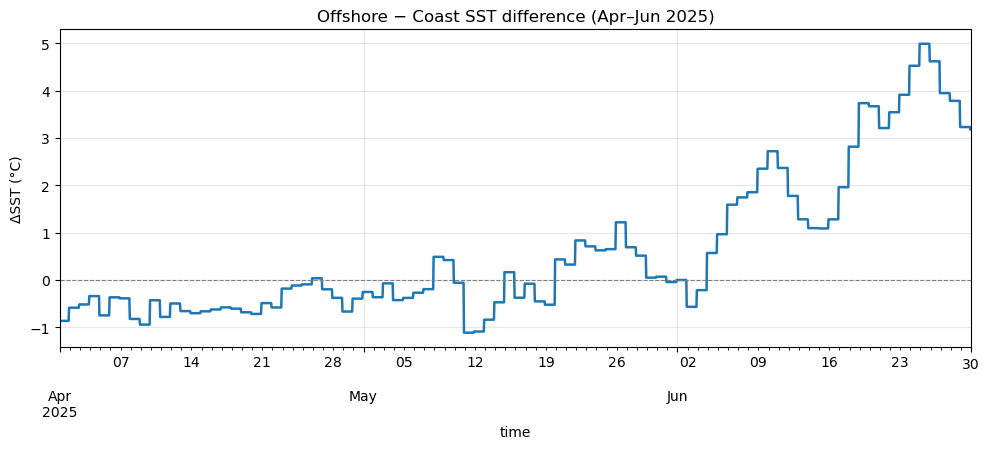

Top 10 days with largest B−A SST difference:
time
2025-06-25 02:00:00    4.98988
2025-06-25 13:00:00    4.98988
2025-06-24 22:00:00    4.98988
2025-06-24 23:00:00    4.98988
2025-06-25 00:00:00    4.98988
2025-06-25 21:00:00    4.98988
2025-06-25 20:00:00    4.98988
2025-06-25 18:00:00    4.98988
2025-06-25 17:00:00    4.98988
2025-06-25 16:00:00    4.98988
Name: ΔSST (B−A, °C), dtype: float32


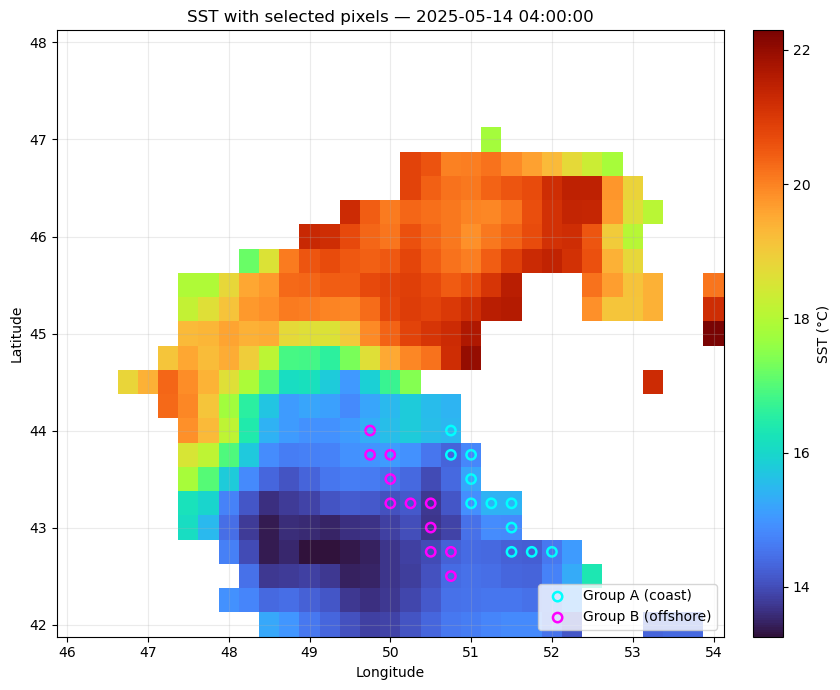

In [4]:
# === Manual pixel selection (no interactivity) & ΔSST time series (Apr–Jun 2025) ===
# Uses 'ds' from era5_caspian_2025_04_06.nc with variables: sst (°C), u10, v10

import numpy as np, pandas as pd, matplotlib.pyplot as plt, xarray as xr

# Harmonize coord names just in case
if "latitude" in ds.dims or "latitude" in ds.coords:  ds = ds.rename(latitude="lat")
if "longitude" in ds.dims or "longitude" in ds.coords: ds = ds.rename(longitude="lon")
time_name = "time" if "time" in ds.coords else "valid_time"

# 0) convenience
T0, T1 = "2025-04-01", "2025-06-30"
dsub = ds.sel({time_name: slice(T0, T1)})

# 1) Inspect grid to help you pick pixels -------------------------------------
print("Lat samples:", dsub.lat.values[:5], "...", dsub.lat.values[-5:])
print("Lon samples:", dsub.lon.values[:5], "...", dsub.lon.values[-5:])
print("Grid shape (lat, lon):", dsub.sizes["lat"], dsub.sizes["lon"])

# 2) DEFINE YOUR PIXEL GROUPS (EDIT THESE) ------------------------------------
# group A = coastal pixels; group B = offshore pixels (indices into dsub.lat/dsub.lon)
groupA_idx = [
    (8,19), (7,19), (7,20), (6,20), (5,20), (5,21), (5,22), (4,22), (3,22), (3,23), (3,24)
]
groupB_idx = [
    (8,15), (7,15), (7,16), (6,16), (5,16), (5,17), (5,18), (4,18), (3,18), (3,19), (2,19)
]

# Optional helper (not used below): get nearest (i,j) from lon/lat values
def lonlat_to_ij(lon_val, lat_val, lon_arr, lat_arr):
    i = int(np.argmin(np.abs(lat_arr - lat_val)))
    j = int(np.argmin(np.abs(lon_arr - lon_val)))
    return i, j

# 3) Build boolean masks for the two groups -----------------------------------
maskA = np.zeros((dsub.sizes["lat"], dsub.sizes["lon"]), dtype=bool)
maskB = np.zeros_like(maskA)

for ilat, jlon in groupA_idx:
    if 0 <= ilat < maskA.shape[0] and 0 <= jlon < maskA.shape[1]:
        maskA[ilat, jlon] = True
for ilat, jlon in groupB_idx:
    if 0 <= ilat < maskB.shape[0] and 0 <= jlon < maskB.shape[1]:
        maskB[ilat, jlon] = True

# safety: disallow overlap
overlap = maskA & maskB
if np.any(overlap):
    print("Warning: some pixels are in both groups; removing from group B.")
    maskB[overlap] = False

# 4) Compute group means (daily) ----------------------------------------------
sstA = dsub["sst"].where(maskA).mean(dim=("lat","lon"), skipna=True)
sstB = dsub["sst"].where(maskB).mean(dim=("lat","lon"), skipna=True)

# ΔSST: offshore - coast (assuming B = offshore; swap if needed)
delta = (sstB - sstA).to_series()
delta.name = "ΔSST (B−A, °C)"

# 5) Quick plot + top dates ----------------------------------------------------
fig, ax = plt.subplots(figsize=(10,4.6))
delta.plot(ax=ax, lw=1.8)
ax.axhline(0, color="gray", ls="--", lw=0.8)
ax.set_ylabel("ΔSST (°C)")
ax.set_title("Offshore − Coast SST difference (Apr–Jun 2025)")
ax.grid(True, alpha=0.3)
plt.tight_layout(); plt.show()

print("Top 10 days with largest B−A SST difference:")
print(delta.sort_values(ascending=False).head(10))

# 6) Map with selected pixels highlighted at a reference time -----------------
ref_ts = "2025-05-14 04:00"
snap = dsub.sel({time_name: ref_ts}, method="nearest")

fig, ax = plt.subplots(figsize=(8.5,7))
im = snap["sst"].plot(ax=ax, cmap="turbo", add_colorbar=False)

# draw selected pixels
yy, xx = np.where(maskA)
ax.scatter(dsub.lon.values[xx], dsub.lat.values[yy], s=45, facecolors="none",
           edgecolors="cyan", linewidths=1.8, label="Group A (coast)")
yy, xx = np.where(maskB)
ax.scatter(dsub.lon.values[xx], dsub.lat.values[yy], s=45, facecolors="none",
           edgecolors="magenta", linewidths=1.8, label="Group B (offshore)")

cbar = plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04); cbar.set_label("SST (°C)")
ax.set_title(f"SST with selected pixels — {pd.to_datetime(snap[time_name].values)}")
ax.set_xlabel("Longitude"); ax.set_ylabel("Latitude")
ax.grid(True, alpha=0.25); ax.legend(loc="lower right")
plt.tight_layout(); plt.show()


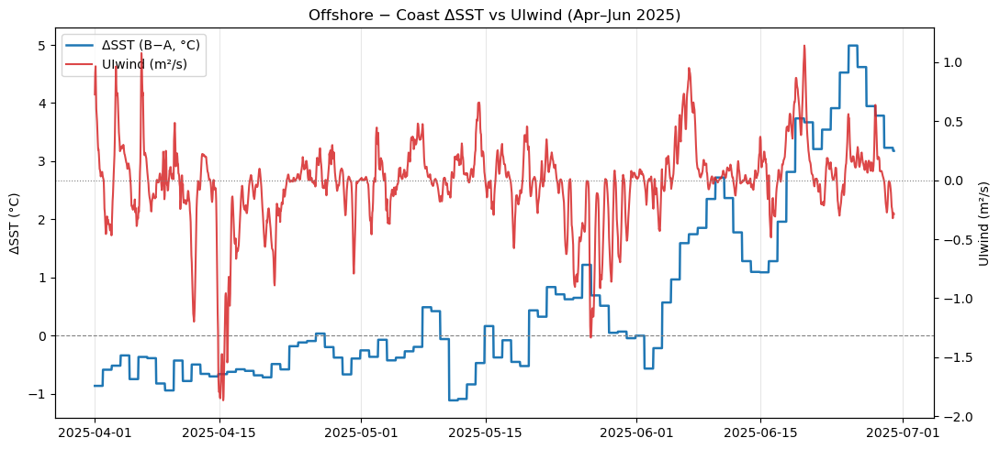

In [5]:
# === UIwind (coastline-normal Ekman transport) over mask region + ΔSST overlay ===
# Reuses: dsub, maskA, maskB, time_name, delta  (from the previous cell)

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Union of the two masks → use same “study area” for wind forcing
mask_union = maskA | maskB

# Area-mean 10 m winds over the union mask
u10_mean = dsub["u10"].where(mask_union).mean(dim=("lat","lon"), skipna=True)
v10_mean = dsub["v10"].where(mask_union).mean(dim=("lat","lon"), skipna=True)

# --- Bulk wind stress and Ekman transport ---
rho_air = 1.225     # kg m^-3
Cd      = 1.3e-3    # drag coefficient
rho_w   = 1025.0    # kg m^-3
Omega   = 7.2921159e-5

# Fort-Shevchenko latitude for Coriolis parameter (adjust if you prefer another site)
FS_LAT = 44.51
f = 2 * Omega * np.sin(np.deg2rad(FS_LAT))

# Wind speed and stress components
U = np.hypot(u10_mean, v10_mean)
tau_x = rho_air * Cd * U * u10_mean
tau_y = rho_air * Cd * U * v10_mean

# Ekman transport components (per unit coastline length)
Qx = tau_y / (rho_w * f)
Qy = -tau_x / (rho_w * f)

# Rotate transport to coastline-normal (Cell 2 orientation ≈ 206.54°)
theta = np.deg2rad(206.54)
UIwind = (-np.sin(theta) * Qx + np.cos(theta) * Qy).to_series()
UIwind.name = "UIwind (m²/s)"

# Align with ΔSST and plot
df_pair = pd.concat([delta, UIwind], axis=1).dropna()

fig, ax1 = plt.subplots(figsize=(11, 5))
ln1, = ax1.plot(df_pair.index, df_pair.iloc[:, 0], lw=1.8, color="tab:blue",
                label=df_pair.columns[0])
ax1.axhline(0, color="gray", ls="--", lw=0.8)
ax1.set_ylabel("ΔSST (°C)")

ax2 = ax1.twinx()
ln2, = ax2.plot(df_pair.index, df_pair.iloc[:, 1], lw=1.5, color="tab:red", alpha=0.85,
                label=df_pair.columns[1])
ax2.axhline(0, color="gray", ls=":", lw=0.8)
ax2.set_ylabel("UIwind (m²/s)")

ax1.set_title("Offshore − Coast ΔSST vs UIwind (Apr–Jun 2025)")
ax1.grid(True, axis="x", alpha=0.3)
ax1.legend([ln1, ln2], [ln1.get_label(), ln2.get_label()], loc="upper left")
plt.tight_layout()
plt.show()


Animation size has reached 21065266 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


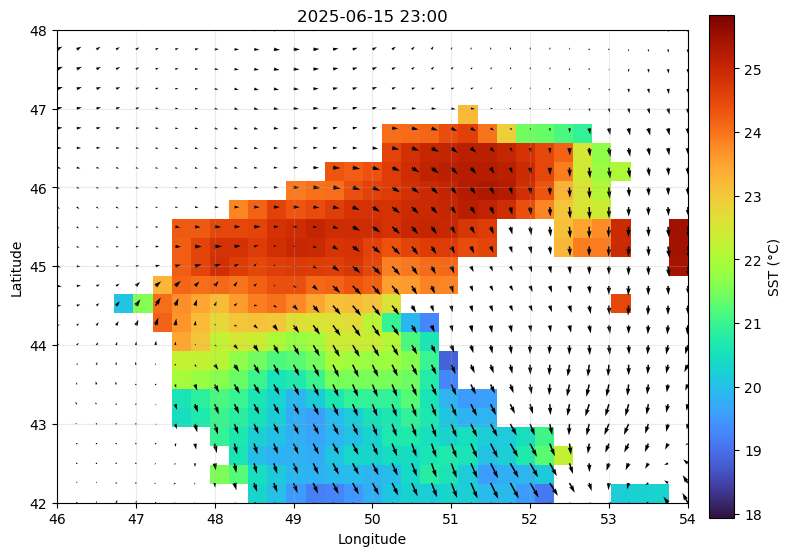

In [6]:
# --- Time-scrubbable animation: SST (°C) + 10 m wind, 2025-06-01 .. 2025-06-15 ---

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Reuse 'ds' from the earlier cell (era5_caspian_2025_04_06.nc) and 'time_name' if defined.
time_name = "time" if "time" in ds.coords else ("valid_time" if "valid_time" in ds.coords else list(ds.coords)[0])

# 0) choose the dataset & time window
start, end = "2025-06-01", "2025-06-15"
sub = ds.sel({time_name: slice(start, end)}).load()
if sub.sizes.get(time_name, 0) == 0:
    raise SystemExit(f"No data in dataset for {start}..{end}")

# 1) coordinate names
lat_name, lon_name = "lat", "lon"

# 2) ensure SST is in °C (usually already converted)
sst_da = sub["sst"]
if float(np.nanmax(sst_da.values)) > 200:   # Kelvin → °C (safety)
    sst_da = sst_da - 273.15
sst_da.name = "sst_c"

# 3) prep time axis (sorted)
times = np.array(pd.to_datetime(sub[time_name].values))
order = np.argsort(times)
times = times[order]

# 4) grid & imshow extent/origin
lon = np.asarray(sub[lon_name].values)
lat = np.asarray(sub[lat_name].values)
origin = "lower" if (lat[1] > lat[0]) else "upper"
extent = [lon.min(), lon.max(), lat.min(), lat.max()]

# 5) consistent color scale over the whole period
vmin = float(np.nanpercentile(sst_da.values, 5))
vmax = float(np.nanpercentile(sst_da.values, 95))

# 6) first frame fields
snap0 = sub.sel({time_name: times[0]}, method="nearest")
sst0  = np.asarray(sst_da.sel({time_name: times[0]}, method="nearest").values)
u0    = np.asarray(snap0["u10"].values)
v0    = np.asarray(snap0["v10"].values)

fig, ax = plt.subplots(figsize=(7.8, 6), constrained_layout=True)

# SST
im = ax.imshow(sst0, extent=extent, origin=origin, cmap="turbo", vmin=vmin, vmax=vmax)

# subsample wind for readability (~20x20 arrows)
skip_y = max(1, u0.shape[0] // 20)
skip_x = max(1, u0.shape[1] // 20)
quiv = ax.quiver(lon[::skip_x], lat[::skip_y],
                 u0[::skip_y, ::skip_x], v0[::skip_y, ::skip_x],
                 scale=400)

cb = fig.colorbar(im, ax=ax, pad=0.02, shrink=0.85)
cb.set_label("SST (°C)")
ttl = ax.set_title(pd.to_datetime(times[0]).strftime("%Y-%m-%d %H:%M"))

ax.set_xlabel("Longitude"); ax.set_ylabel("Latitude")
ax.grid(True, alpha=0.25)

def update(i):
    t = times[i]
    # update SST
    sst_i = np.asarray(sst_da.sel({time_name: t}, method="nearest").values)
    im.set_data(sst_i)
    # update wind (respect the same subsampling as init)
    snap = sub.sel({time_name: t}, method="nearest")
    u_i = np.asarray(snap["u10"].values)[::skip_y, ::skip_x]
    v_i = np.asarray(snap["v10"].values)[::skip_y, ::skip_x]
    quiv.set_UVC(u_i, v_i)
    # title
    ttl.set_text(pd.to_datetime(t).strftime("%Y-%m-%d %H:%M"))
    return im, quiv, ttl

ani = FuncAnimation(fig, update, frames=len(times), interval=300, blit=False)

# In a notebook: interactive scrubber + play/pause
HTML(ani.to_jshtml())